In [2]:
from typing import Dict, Iterable, Optional

import numpy as np
import torch
from torch.distributions import Normal, Poisson
from torch.distributions import kl_divergence as kld
from torch import tensor
import scanpy as sc
import anndata
import pandas as pd
import tools
import logging
import mira

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
## model setup
atac_model = mira.topics.AccessibilityTopicModel(counts_layer='counts',
                                                 dataset_loader_workers = 3)

rna_model = mira.topics.ExpressionTopicModel(
    endogenous_key='endog',
    exogenous_key='endog',
    counts_layer='counts',
    seed = 0,
    hidden=64, # to make the tutorial faster. In practice, use the default of 128!
)          


rna_model = mira.topics.ExpressionTopicModel.load('MIRA/hair_rna_topic_model.pth')
atac_model = mira.topics.AccessibilityTopicModel.load('MIRA/hair_atac_topic_model.pth')

INFO:mira.topic_model.base:Moving model to CPU for inference.
INFO:mira.topic_model.base:Moving model to device: cpu
INFO:mira.topic_model.base:Moving model to CPU for inference.
INFO:mira.topic_model.base:Moving model to device: cpu


In [61]:
mira.datasets.ShareseqTopicModels()


INFO:mira.datasets.datasets:Dataset contents:
	* mira-datasets/shareseq_topic_models
		* atac_model.pth
		* rna_model.pth


In [62]:
mira.datasets.ShareseqAnnotatedData()


INFO:mira.datasets.datasets:Dataset contents:
	* mira-datasets/shareseq_annotated_data
		* rna_data.joint_representation.rp_modeled.h5ad
		* atac_data.joint_representation.motif_calls.tss_annotated.h5ad


In [77]:
rna_data_2 = anndata.read_h5ad("mira-datasets/shareseq_annotated_data/rna_data.joint_representation.rp_modeled.h5ad")
atac_data_2 = anndata.read_h5ad("mira-datasets/shareseq_annotated_data/atac_data.joint_representation.motif_calls.tss_annotated.h5ad")

In [79]:
atac_data_2.obs

,topic_0,topic_1,topic_2,topic_3,topic_4,topic_5,topic_6,topic_7,topic_8,topic_9,...,topic_16,topic_17,topic_18,topic_19,topic_20,topic_21,topic_22,topic_23,true_cell,softmax_denom
barcode,,,,,,,,,,,,,,,,,,,,,
R1.01.R2.01.R3.43.P1.56,0.000042,0.004247,0.033373,0.155005,0.362701,0.132166,0.000502,0.017802,0.002598,0.075506,...,0.008418,0.000174,0.000282,0.075765,0.000253,0.004249,0.113360,0.000152,Outer Infandibulum,503262.43750
R1.01.R2.02.R3.21.P1.56,0.117221,0.000473,0.000488,0.000347,0.001203,0.001649,0.001706,0.010007,0.019743,0.024397,...,0.001285,0.006243,0.004791,0.003423,0.000553,0.005177,0.001985,0.122221,IRS,452864.65625
R1.01.R2.02.R3.38.P1.56,0.000486,0.220237,0.002029,0.000077,0.000941,0.001210,0.438750,0.007092,0.051289,0.001383,...,0.000079,0.000829,0.000696,0.001022,0.115664,0.003525,0.001274,0.000331,Upper Basal,531753.12500
R1.01.R2.03.R3.28.P1.53,0.000830,0.000018,0.001310,0.015675,0.531584,0.003838,0.000523,0.006250,0.001209,0.019871,...,0.012323,0.109247,0.000565,0.003845,0.000104,0.011105,0.001428,0.009427,Inner Bulge,496212.12500
R1.01.R2.03.R3.61.P1.54,0.001196,0.000057,0.000015,0.000557,0.072305,0.000278,0.000588,0.033774,0.002316,0.010079,...,0.001607,0.570939,0.001219,0.000832,0.000033,0.115076,0.000072,0.114126,Medulla,471989.68750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
R1.96.R2.92.R3.27.P1.54,0.561244,0.000038,0.002369,0.001056,0.001509,0.000061,0.000117,0.000476,0.000275,0.010804,...,0.007948,0.013342,0.000540,0.000439,0.000204,0.001561,0.000699,0.018923,Matrix,436659.68750
R1.96.R2.92.R3.28.P1.56,0.130115,0.003009,0.009439,0.001975,0.009521,0.009145,0.001253,0.034315,0.007822,0.028367,...,0.001692,0.030738,0.006225,0.011425,0.003117,0.013690,0.010870,0.124576,Matrix,442822.09375
R1.96.R2.92.R3.83.P1.54,0.000210,0.153376,0.009764,0.002094,0.002604,0.001298,0.239157,0.006557,0.011004,0.003587,...,0.003679,0.001703,0.001671,0.000878,0.491935,0.000911,0.003969,0.000639,Upper Basal,545013.25000


In [82]:
[e for e in atac_data_2.obs.index.tolist() if "R1.01.R2.06.R3.83." in e]

['R1.01.R2.06.R3.83.P1.55']

In [85]:
## loading the data
rna_data = anndata.read_h5ad("data/datasets/mouse_hair_rna_interim.h5ad")
atac_data =  anndata.read_h5ad("data/datasets/mouse_hair_atac_interim.h5ad")

In [94]:
atac_data.var

,feature_types,modality,n_cells,chr,start,end
Id,,,,,,
0,Peaks,Peaks,4078,chrX,143482906,143483206
1,Peaks,Peaks,4088,chr6,3200976,3201276
2,Peaks,Peaks,2032,chr9,123461850,123462150
3,Peaks,Peaks,2082,chr1,56782095,56782395
4,Peaks,Peaks,1850,chr9,56223668,56223968
...,...,...,...,...,...,...
344411,Peaks,Peaks,73,chr10,81232540,81232840
344496,Peaks,Peaks,78,chr10,3862097,3862397
344514,Peaks,Peaks,94,chr10,24784301,24784601


In [108]:
"AKT2" in pd.DataFrame(atac_data_2.uns["TSS_metadata"]).gene.tolist()

True

In [106]:
rna_data.var[rna_data.var.highly_variable==True]

,feature_types,modality,n_cells,highly_variable,means,dispersions,dispersions_norm,exog,endog
index,,,,,,,,,
Abcf2,Gene Expression,Gene Expression,492,True,1.619382,4.389581,0.627253,True,False
Adamts9,Gene Expression,Gene Expression,401,True,1.612930,4.541856,2.359316,True,True
Aff3,Gene Expression,Gene Expression,1359,True,2.767782,4.530842,0.894974,True,True
Agl,Gene Expression,Gene Expression,408,True,1.457034,4.354157,0.224318,True,False
Akt2,Gene Expression,Gene Expression,317,True,1.241102,4.380297,0.505747,True,False
...,...,...,...,...,...,...,...,...,...
Ythdc2,Gene Expression,Gene Expression,520,True,1.655478,4.364199,0.338543,True,False
Zfp385a,Gene Expression,Gene Expression,341,True,1.346509,4.413190,0.829114,True,True
Zfp462,Gene Expression,Gene Expression,442,True,1.593190,4.430925,1.097520,True,True


In [113]:
rna_model.predict(rna_data)
# rna_data.write_h5ad("data/datasets/mouse_hair_")

Predicting latent vars: 100%|██████████| 13/13 [00:01<00:00, 12.22it/s]
INFO:mira.adata_interface.core:Added key to obsm: X_topic_compositions
INFO:mira.adata_interface.topic_model:Added cols: topic_0, topic_1, topic_2, topic_3, topic_4, topic_5, topic_6, topic_7, topic_8, topic_9, topic_10, topic_11, topic_12, topic_13
INFO:mira.adata_interface.core:Added key to varm: topic_feature_compositions
INFO:mira.adata_interface.core:Added key to varm: topic_feature_activations
INFO:mira.adata_interface.topic_model:Added key to uns: topic_dendogram


In [92]:
atac_data.obs

,atac.bc,celltype,latent_time,batch_id,modality,_scvi_batch,_scvi_labels,epxr_latent_0,epxr_latent_1,epxr_latent_2,...,atac_latent_0,atac_latent_1,atac_latent_2,atac_latent_3,atac_latent_4,atac_latent_5,atac_latent_6,atac_latent_7,atac_latent_8,atac_latent_9
0_paired,"R1.01,R2.06,R3.83,P1.07",TAC-1,0.366586,1,paired,0,0,-0.329691,0.349999,-0.094741,...,-0.203164,-0.307153,1.272171,1.461663,0.203151,1.204773,0.983803,-0.717861,-1.309741,0.859182
1_paired,"R1.01,R2.11,R3.86,P1.08",TAC-1,0.387718,1,paired,0,0,-0.209401,1.059089,0.475534,...,-1.524136,-1.366183,1.374669,5.397980,-2.937887,0.450710,0.839794,1.374887,-1.753175,0.711788
2_paired,"R1.01,R2.15,R3.09,P1.07",TAC-1,0.147633,1,paired,0,0,-0.547288,-0.103089,0.148641,...,0.118971,-0.700547,0.623554,1.376196,-0.965489,-0.267835,1.032686,-1.038676,0.113965,-0.069991
3_paired,"R1.01,R2.17,R3.81,P1.05",TAC-1,0.356577,1,paired,0,0,-0.258864,-0.088589,-1.091653,...,0.457141,-0.155438,0.982293,1.731557,0.881012,0.012297,0.265299,-0.449946,-1.501590,1.654312
4_paired,"R1.01,R2.18,R3.95,P1.06",TAC-1,0.131708,1,paired,0,0,0.651902,0.508803,-0.290743,...,-0.182966,-0.076396,-0.361015,1.166404,0.148023,0.288433,-0.024054,0.215846,-0.896238,-0.784071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6431_paired,"R1.96,R2.73,R3.72,P1.08",Hair Shaft-cuticle.cortex,0.345225,1,paired,0,0,0.450251,0.547970,-0.263151,...,0.814423,-1.003422,0.827930,-0.545676,-0.686469,0.466615,0.990670,-0.682911,-0.254094,0.169781
6432_paired,"R1.96,R2.82,R3.52,P1.07",Hair Shaft-cuticle.cortex,0.313259,1,paired,0,0,0.781673,-0.192597,0.503431,...,-0.190039,0.087952,1.417515,-1.071929,-0.388000,0.263565,0.180027,-0.901837,0.458283,0.569222
6433_paired,"R1.96,R2.83,R3.68,P1.06",Hair Shaft-cuticle.cortex,0.343906,1,paired,0,0,-0.965674,0.367740,-0.886593,...,0.640420,-1.371771,0.939666,-1.318798,-0.363493,0.193512,-0.122131,-0.135640,0.752586,-1.245537
6434_paired,"R1.96,R2.87,R3.63,P1.07",Hair Shaft-cuticle.cortex,0.475595,1,paired,0,0,1.658696,-1.205393,0.108684,...,0.570421,-1.032960,1.415159,-1.103582,-1.183785,-0.267656,-0.624776,0.997868,0.320817,1.073898


In [70]:
rna_data.obs

,atac.bc,celltype,latent_time,batch_id,modality,_scvi_batch,_scvi_labels,epxr_latent_0,epxr_latent_1,epxr_latent_2,...,atac_latent_0,atac_latent_1,atac_latent_2,atac_latent_3,atac_latent_4,atac_latent_5,atac_latent_6,atac_latent_7,atac_latent_8,atac_latent_9
0_paired,"R1.01,R2.06,R3.83,P1.07",TAC-1,0.366586,1,paired,0,0,-0.329691,0.349999,-0.094741,...,-0.203164,-0.307153,1.272171,1.461663,0.203151,1.204773,0.983803,-0.717861,-1.309741,0.859182
1_paired,"R1.01,R2.11,R3.86,P1.08",TAC-1,0.387718,1,paired,0,0,-0.209401,1.059089,0.475534,...,-1.524136,-1.366183,1.374669,5.397980,-2.937887,0.450710,0.839794,1.374887,-1.753175,0.711788
2_paired,"R1.01,R2.15,R3.09,P1.07",TAC-1,0.147633,1,paired,0,0,-0.547288,-0.103089,0.148641,...,0.118971,-0.700547,0.623554,1.376196,-0.965489,-0.267835,1.032686,-1.038676,0.113965,-0.069991
3_paired,"R1.01,R2.17,R3.81,P1.05",TAC-1,0.356577,1,paired,0,0,-0.258864,-0.088589,-1.091653,...,0.457141,-0.155438,0.982293,1.731557,0.881012,0.012297,0.265299,-0.449946,-1.501590,1.654312
4_paired,"R1.01,R2.18,R3.95,P1.06",TAC-1,0.131708,1,paired,0,0,0.651902,0.508803,-0.290743,...,-0.182966,-0.076396,-0.361015,1.166404,0.148023,0.288433,-0.024054,0.215846,-0.896238,-0.784071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6431_paired,"R1.96,R2.73,R3.72,P1.08",Hair Shaft-cuticle.cortex,0.345225,1,paired,0,0,0.450251,0.547970,-0.263151,...,0.814423,-1.003422,0.827930,-0.545676,-0.686469,0.466615,0.990670,-0.682911,-0.254094,0.169781
6432_paired,"R1.96,R2.82,R3.52,P1.07",Hair Shaft-cuticle.cortex,0.313259,1,paired,0,0,0.781673,-0.192597,0.503431,...,-0.190039,0.087952,1.417515,-1.071929,-0.388000,0.263565,0.180027,-0.901837,0.458283,0.569222
6433_paired,"R1.96,R2.83,R3.68,P1.06",Hair Shaft-cuticle.cortex,0.343906,1,paired,0,0,-0.965674,0.367740,-0.886593,...,0.640420,-1.371771,0.939666,-1.318798,-0.363493,0.193512,-0.122131,-0.135640,0.752586,-1.245537
6434_paired,"R1.96,R2.87,R3.63,P1.07",Hair Shaft-cuticle.cortex,0.475595,1,paired,0,0,1.658696,-1.205393,0.108684,...,0.570421,-1.032960,1.415159,-1.103582,-1.183785,-0.267656,-0.624776,0.997868,0.320817,1.073898


In [117]:
atac_data.layers["counts"] =atac_data.X.copy()

In [76]:
atac_data.obs

,atac.bc,celltype,latent_time,batch_id,modality,_scvi_batch,_scvi_labels,epxr_latent_0,epxr_latent_1,epxr_latent_2,...,atac_latent_0,atac_latent_1,atac_latent_2,atac_latent_3,atac_latent_4,atac_latent_5,atac_latent_6,atac_latent_7,atac_latent_8,atac_latent_9
0_paired,"R1.01,R2.06,R3.83,P1.07",TAC-1,0.366586,1,paired,0,0,-0.329691,0.349999,-0.094741,...,-0.203164,-0.307153,1.272171,1.461663,0.203151,1.204773,0.983803,-0.717861,-1.309741,0.859182
1_paired,"R1.01,R2.11,R3.86,P1.08",TAC-1,0.387718,1,paired,0,0,-0.209401,1.059089,0.475534,...,-1.524136,-1.366183,1.374669,5.397980,-2.937887,0.450710,0.839794,1.374887,-1.753175,0.711788
2_paired,"R1.01,R2.15,R3.09,P1.07",TAC-1,0.147633,1,paired,0,0,-0.547288,-0.103089,0.148641,...,0.118971,-0.700547,0.623554,1.376196,-0.965489,-0.267835,1.032686,-1.038676,0.113965,-0.069991
3_paired,"R1.01,R2.17,R3.81,P1.05",TAC-1,0.356577,1,paired,0,0,-0.258864,-0.088589,-1.091653,...,0.457141,-0.155438,0.982293,1.731557,0.881012,0.012297,0.265299,-0.449946,-1.501590,1.654312
4_paired,"R1.01,R2.18,R3.95,P1.06",TAC-1,0.131708,1,paired,0,0,0.651902,0.508803,-0.290743,...,-0.182966,-0.076396,-0.361015,1.166404,0.148023,0.288433,-0.024054,0.215846,-0.896238,-0.784071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6431_paired,"R1.96,R2.73,R3.72,P1.08",Hair Shaft-cuticle.cortex,0.345225,1,paired,0,0,0.450251,0.547970,-0.263151,...,0.814423,-1.003422,0.827930,-0.545676,-0.686469,0.466615,0.990670,-0.682911,-0.254094,0.169781
6432_paired,"R1.96,R2.82,R3.52,P1.07",Hair Shaft-cuticle.cortex,0.313259,1,paired,0,0,0.781673,-0.192597,0.503431,...,-0.190039,0.087952,1.417515,-1.071929,-0.388000,0.263565,0.180027,-0.901837,0.458283,0.569222
6433_paired,"R1.96,R2.83,R3.68,P1.06",Hair Shaft-cuticle.cortex,0.343906,1,paired,0,0,-0.965674,0.367740,-0.886593,...,0.640420,-1.371771,0.939666,-1.318798,-0.363493,0.193512,-0.122131,-0.135640,0.752586,-1.245537
6434_paired,"R1.96,R2.87,R3.63,P1.07",Hair Shaft-cuticle.cortex,0.475595,1,paired,0,0,1.658696,-1.205393,0.108684,...,0.570421,-1.032960,1.415159,-1.103582,-1.183785,-0.267656,-0.624776,0.997868,0.320817,1.073898


In [118]:
atac_model.predict(atac_data)

Predicting latent vars: 100%|██████████| 13/13 [00:12<00:00,  1.03it/s]
INFO:mira.adata_interface.core:Added key to obsm: X_topic_compositions
INFO:mira.adata_interface.topic_model:Added cols: topic_0, topic_1, topic_2, topic_3, topic_4, topic_5, topic_6, topic_7, topic_8
INFO:mira.adata_interface.core:Added key to varm: topic_feature_compositions
INFO:mira.adata_interface.core:Added key to varm: topic_feature_activations
INFO:mira.adata_interface.topic_model:Added key to uns: topic_dendogram


In [27]:
rna_data.write_h5ad("data/datasets/mouse_hair_mira_rna.h5ad")
atac_data.write_h5ad("data/datasets/mouse_hair_mira_atac.h5ad")


In [4]:
rna_data = sc.read_h5ad("data/datasets/mouse_hair_mira_rna.h5ad")
atac_data = sc.read_h5ad("data/datasets/mouse_hair_mira_atac.h5ad")

In [9]:
mira.datasets.mm10_chrom_sizes()
mira.datasets.mm10_tss_data()

INFO:mira.datasets.datasets:Dataset contents:
	* mira-datasets/mm10.chrom.sizes
INFO:mira.datasets.datasets:Dataset contents:
	* mira-datasets/mm10_tss_data.bed12


In [10]:
!head -n3 mira-datasets/mm10.chrom.sizes


chr1	195471971
chr2	182113224
chrX	171031299


In [12]:
rna_data

AnnData object with n_obs × n_vars = 6436 × 959
    obs: 'atac.bc', 'celltype', 'latent_time', 'batch_id', 'modality', '_scvi_batch', '_scvi_labels', 'epxr_latent_0', 'epxr_latent_1', 'epxr_latent_2', 'epxr_latent_3', 'epxr_latent_4', 'epxr_latent_5', 'epxr_latent_6', 'epxr_latent_7', 'epxr_latent_8', 'epxr_latent_9', 'atac_latent_0', 'atac_latent_1', 'atac_latent_2', 'atac_latent_3', 'atac_latent_4', 'atac_latent_5', 'atac_latent_6', 'atac_latent_7', 'atac_latent_8', 'atac_latent_9', 'model_read_scale', 'topic_0', 'topic_1', 'topic_2', 'topic_3', 'topic_4', 'topic_5', 'topic_6', 'topic_7', 'topic_8', 'topic_9', 'topic_10', 'topic_11', 'topic_12', 'topic_13'
    var: 'feature_types', 'modality', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'exog', 'endog'
    uns: 'hvg', 'log1p', 'neighbors', 'umap', 'topic_dendogram'
    obsm: 'X_umap', 'X_topic_compositions'
    varm: 'topic_feature_compositions', 'topic_feature_activations'
    layers: 'counts'
    obsp:

In [53]:
## ATAC data get TSS annotation

mira.tl.get_distance_to_TSS(atac_data,
                            tss_data='mira-datasets/mm10_tss_data.bed12',
                            genome_file='mira-datasets/mm10.chrom.sizes')

INFO:mira.tools.connect_genes_peaks:Finding peak intersections with promoters ...
INFO:mira.tools.connect_genes_peaks:Calculating distances between peaks and TSS ...
INFO:mira.tools.connect_genes_peaks:Masking other genes' promoters ...
INFO:mira.adata_interface.rp_model:Added key to var: distance_to_TSS
INFO:mira.adata_interface.rp_model:Added key to uns: distance_to_TSS_genes


In [12]:
atac_data.write_h5ad("data/datasets/mouse_hair_atac_interim.h5ad")

In [5]:
del rna_data.obsm["X_topic_compositions"]

In [6]:
rna_data

AnnData object with n_obs × n_vars = 6436 × 959
    obs: 'atac.bc', 'celltype', 'latent_time', 'batch_id', 'modality', '_scvi_batch', '_scvi_labels', 'epxr_latent_0', 'epxr_latent_1', 'epxr_latent_2', 'epxr_latent_3', 'epxr_latent_4', 'epxr_latent_5', 'epxr_latent_6', 'epxr_latent_7', 'epxr_latent_8', 'epxr_latent_9', 'atac_latent_0', 'atac_latent_1', 'atac_latent_2', 'atac_latent_3', 'atac_latent_4', 'atac_latent_5', 'atac_latent_6', 'atac_latent_7', 'atac_latent_8', 'atac_latent_9'
    var: 'feature_types', 'modality', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'exog', 'endog'
    uns: 'hvg', 'log1p', 'neighbors', 'umap'
    obsm: 'X_umap'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [6]:
rp_args = dict(expr_adata = rna_data, atac_adata= atac_data)
rp_genes = list(rna_model.features[rna_model.highly_variable])
rp_genes = [str(e).upper() for e in rp_genes]

In [55]:
rp_genes = rp_genes
rp_genes

['Aak1',
 'Aasdh',
 'Abcc1',
 'Abcf2',
 'Abl1',
 'Abl2',
 'Ace2',
 'Acot9',
 'Acvr1',
 'Acvr1b',
 'Adamts9',
 'Adarb1',
 'Aff3',
 'Afg3l1',
 'Aftph',
 'Agl',
 'Agpat3',
 'Agpat5',
 'Agtpbp1',
 'Ahi1',
 'Ak2',
 'Akap1',
 'Akap10',
 'Akap8l',
 'Akt2',
 'Alcam',
 'Aldh1a3',
 'Ankrd10',
 'Ankrd17',
 'Ankrd26',
 'Ankrd52',
 'Anln',
 'Anxa1',
 'Apbb2',
 'Appl1',
 'Areg',
 'Arfgap2',
 'Arhgap29',
 'Arhgef1',
 'Arhgef10',
 'Arhgef10l',
 'Arhgef26',
 'Arid1a',
 'Asah1',
 'Asb3',
 'Atad2',
 'Atad2b',
 'Atad5',
 'Ate1',
 'Atf3',
 'Atf7ip',
 'Atg7',
 'Atox1',
 'Atp11a',
 'Atp13a2',
 'Atp2a2',
 'Atp8a1',
 'Atp9b',
 'Atr',
 'Atxn2l',
 'Atxn7l1',
 'Azin1',
 'B3galnt2',
 'B3gntl1',
 'B4galt1',
 'BC005561',
 'Bambi',
 'Bard1',
 'Baz1a',
 'Baz1b',
 'Baz2b',
 'Bhlhe40',
 'Blm',
 'Bmp2k',
 'Bmper',
 'Bnc2',
 'Braf',
 'Brca1',
 'Brca2',
 'Brd1',
 'Brd2',
 'Brd7',
 'Brd8',
 'Brd9',
 'Brix1',
 'Btg2',
 'Cachd1',
 'Cacng4',
 'Cacul1',
 'Cadm1',
 'Cald1',
 'Camk2d',
 'Cast',
 'Cbx4',
 'Cc2d2a',
 'Ccdc171',
 'C

In [32]:
rna_data.var_names

Index(['1700025G04Rik', '2610507B11Rik', '4833420G17Rik', '5031439G07Rik',
       '9930021J03Rik', 'Aak1', 'Aasdh', 'Abcc1', 'Abcf2', 'Abl1',
       ...
       'Zfp750', 'Zfyve16', 'Zgrf1', 'Zmym4', 'Zmynd8', 'Znhit6', 'Znrf1',
       'Zranb3', 'Zswim6', 'Zzef1'],
      dtype='object', name='index', length=959)

In [7]:
litemodel = mira.rp.LITE_Model(expr_model = rna_model,
                              accessibility_model=atac_model,
                              counts_layer='counts',
                              genes = rp_genes)

In [8]:
litemodel.load("rpmodels/mira/hair")

In [51]:
"1700025G04RIK" in rna_data.var_names

False

In [128]:
rna_data.var.index = rna_data.var.index.str.upper()

In [129]:
rna_data.var

,feature_types,modality,n_cells,highly_variable,means,dispersions,dispersions_norm,exog,endog
index,,,,,,,,,
1700025G04RIK,Gene Expression,Gene Expression,1177,False,2.535499,4.398642,0.056588,False,False
2610507B11RIK,Gene Expression,Gene Expression,876,False,2.112825,4.291477,-0.596205,False,False
4833420G17RIK,Gene Expression,Gene Expression,648,False,1.849404,4.241606,-0.847347,False,False
5031439G07RIK,Gene Expression,Gene Expression,368,False,1.364747,4.306948,-0.215351,False,False
9930021J03RIK,Gene Expression,Gene Expression,787,False,2.047196,4.364122,0.098936,False,False
...,...,...,...,...,...,...,...,...,...
ZNHIT6,Gene Expression,Gene Expression,418,False,1.456709,4.282283,-0.593214,False,False
ZNRF1,Gene Expression,Gene Expression,1092,False,2.326576,4.282798,-0.662185,False,False
ZRANB3,Gene Expression,Gene Expression,309,False,1.289990,4.323316,-0.054443,False,False


In [132]:
litemodel.fit(**rp_args, n_workers=4,
              callback = mira.rp.SaveCallback("rpmodels/mira/hair"))

Fitting models:   1%|          | 6/959 [00:00<02:59,  5.32it/s]

Fitting models: 100%|██████████| 959/959 [05:28<00:00,  2.92it/s]


In [9]:
rna_data.obs["latent_time_cat"] = pd.cut(rna_data.obs['latent_time'], 20, labels=[str(i) for i in range(20)])

In [96]:
rna_data.obs["latent_time_2"] = pd.cut(rna_data.obs['latent_time'], 50, labels=[str(i) for i in range(50)])

In [193]:
rna_data.obs["latent_time_3"] = pd.cut(rna_data.obs['latent_time'], 5, labels=[str(i) for i in range(5)])


In [166]:
atac_data.var

,index,Id,feature_types,modality,n_cells,chr,start,end
0,0,0,Peaks,Peaks,4078,chrX,143482906,143483206
1,1,1,Peaks,Peaks,4088,chr6,3200976,3201276
2,2,2,Peaks,Peaks,2032,chr9,123461850,123462150
3,3,3,Peaks,Peaks,2082,chr1,56782095,56782395
4,4,4,Peaks,Peaks,1850,chr9,56223668,56223968
...,...,...,...,...,...,...,...,...
112651,112651,344411,Peaks,Peaks,73,chr10,81232540,81232840
112652,112652,344496,Peaks,Peaks,78,chr10,3862097,3862397
112653,112653,344514,Peaks,Peaks,94,chr10,24784301,24784601
112654,112654,344571,Peaks,Peaks,102,chr10,119454428,119454728


In [10]:
### Plot local genes and local peaks
from scipy.sparse import csr_matrix
from scipy.sparse import diags


def tfidf_norm(adata_atac, scale_factor=1e4):
    """TF-IDF normalization.
    This function normalizes counts in an AnnData object with TF-IDF.
    Parameters
    ----------
    adata_atac: :class:`~anndata.AnnData`
        ATAC anndata object.
    scale_factor: `float` (default: 1e4)
        Value to be multiplied after normalization.
    copy: `bool` (default: `False`)
        Whether to return a copy or modify `.X` directly.
    Returns
    -------
    If `copy==True`, a new ATAC anndata object which stores normalized counts in `.X`.
    """
    npeaks = adata_atac.X.sum(1)
    npeaks_inv = csr_matrix(1.0/npeaks)
    tf = adata_atac.X.multiply(npeaks_inv)
    idf = diags(np.ravel(adata_atac.X.shape[0] / adata_atac.X.sum(0))).log1p()
    new_X = tf.dot(idf) * scale_factor
    return new_X


In [11]:
norm_X = tfidf_norm(atac_data)

In [140]:
norm_X.shape

(6436, 112656)

In [12]:
atac_data.layers["norm"] = norm_X

In [145]:
atac_data[:,:10].layers["norm"].shape

(6436, 10)

In [115]:
def aggregate_local_atac(table, atac_data_new):
    indices = table.index.to_numpy().astype(np.int64)
    real_index = []
    
    for ind in indices:
        real_index.extend(atac_data.var[atac_data.var.Id==str(ind)].index.tolist())

    gene_peaks = atac_data_new[:, real_index].layers["norm"]
    gene_peaks = np.sum(gene_peaks, axis=1)
    
    return gene_peaks

def get_gene_local_atac(genename, litemodel, rna_data, atac_data, norm_X):
    table = litemodel[genename].get_influential_local_peaks(atac_data, decay_periods = 8.)
    peaks = aggregate_local_atac(table, atac_data)

    rna_data.obs["local_peaks"] = peaks

def get_gene_local_atac_mtx(genenames, litemodel, rna_data, atac_data, norm_X):
    for genename in genenames:
        table = litemodel[genename].get_influential_local_peaks(atac_data, decay_periods = 8.)
        peaks = aggregate_local_atac(table, atac_data)
        name = genename+"local_peaks"
        rna_data.obs[name] = peaks


In [123]:
import matplotlib.pyplot as plt
from scipy.interpolate import make_interp_spline

def get_norm_gene_local(genename,time):
    peak_mean = rna_data.obs.groupby(time)["local_peaks"].mean()
    rna_data.obs["temp_gene"] =   rna_data[:,[genename.capitalize()]].X.toarray()
    gene_mean = rna_data.obs.groupby(time)["temp_gene"].mean()
    timelist = rna_data.obs.time.unique().tolist()
    genesplie = make_interp_spline(np.array(timelist), gene_mean.value)

    df = pd.DataFrame([peak_mean, gene_mean, genesplie]).T
    df = df.reset_index()
    fig, ax = plt.subplots()
    df.plot(x=time, y = "local_peaks", ax=ax)
    df.plot(x=time, y = "temp_gene", ax=ax,secondary_y=True, color="r")



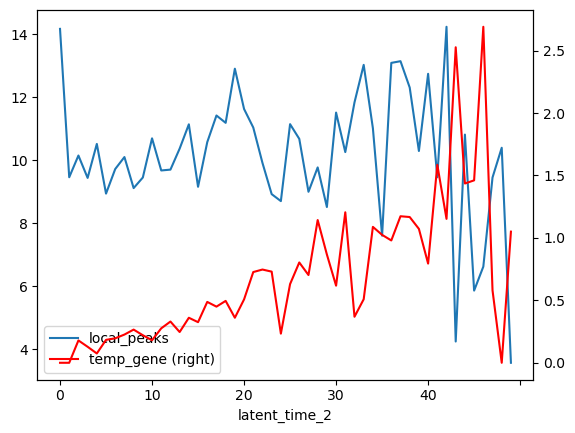

In [122]:
get_norm_gene_local("Ctsc", "latent_time_2")

In [208]:
def smooth_gene_peaks_plot(genename,time, linewidth, points=1000, save=False, legend=True):
    peak_mean = rna_data.obs.groupby(time)["local_peaks"].mean()
    rna_data.obs["temp_gene"] =   rna_data[:,[genename.capitalize()]].X.toarray()
    gene_mean = rna_data.obs.groupby(time)["temp_gene"].mean()
    timelist = rna_data.obs[time].unique()
    timelist = timelist.astype(np.float64)
    timelist = sorted(timelist)
    genesplie = make_interp_spline(np.array(timelist), gene_mean.values)
    peaksplie = make_interp_spline(np.array(timelist), peak_mean.values)
    X_ = np.linspace(timelist[0], timelist[-1], points)
    smooth_gene = genesplie(X_)
    smooth_peaks = peaksplie(X_)
    df = pd.DataFrame(index=X_)
    df["smooth_gene"] = smooth_gene
    df["smooth_peaks"] = smooth_peaks
    df = df.reset_index() 
    fig, ax = plt.subplots()
    # ax.grid(True)
        
    df.plot(x="index", y = "smooth_peaks", ax=ax, linewidth=linewidth, legend=legend)
    df.plot(x="index", y = "smooth_gene", ax=ax,secondary_y=True, color="r", linewidth=linewidth, legend=legend)
    if save:
        fig.savefig(save)

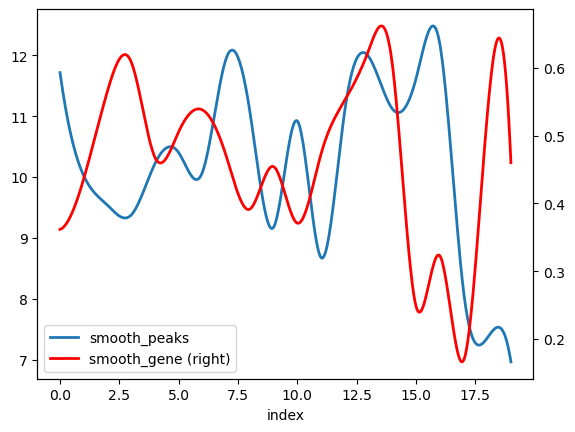

In [170]:
smooth_gene_peaks_plot("sik1", "latent_time_cat",2, points=500)

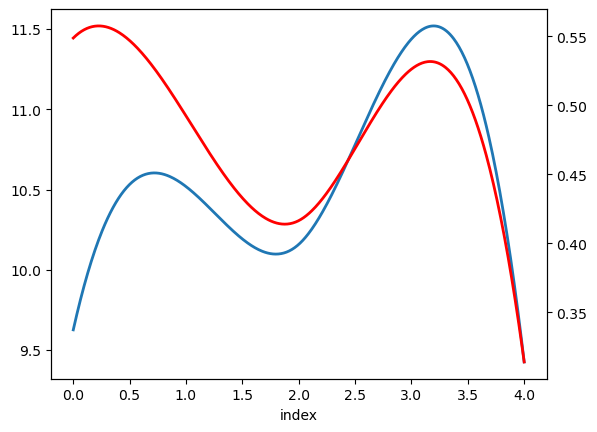

In [202]:
smooth_gene_peaks_plot("sik1", "latent_time_3",2, points=500, save="figs/Hair/sik1.pdf")

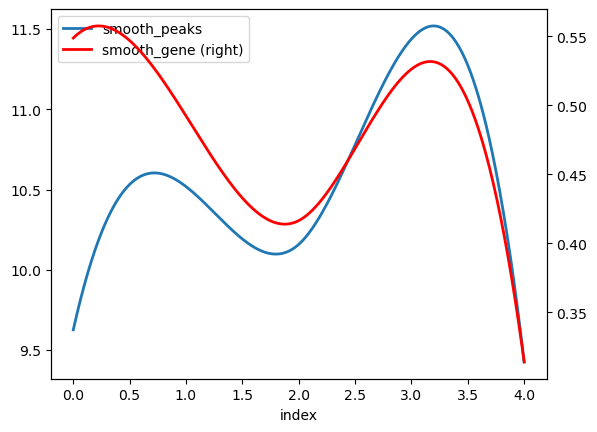

In [209]:
smooth_gene_peaks_plot("sik1", "latent_time_3",2, points=500)

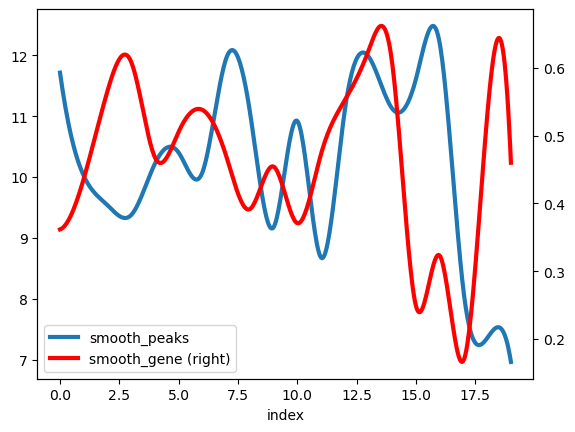

In [185]:
smooth_gene_peaks_plot("Sik1", "latent_time_cat", 3, points=500)

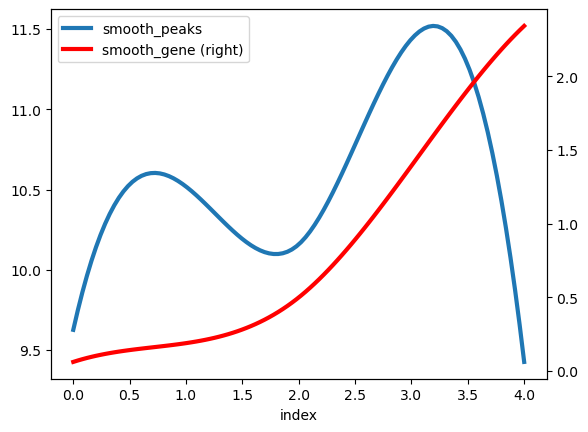

In [195]:
smooth_gene_peaks_plot("Krt27", "latent_time_3", 3, points=100)

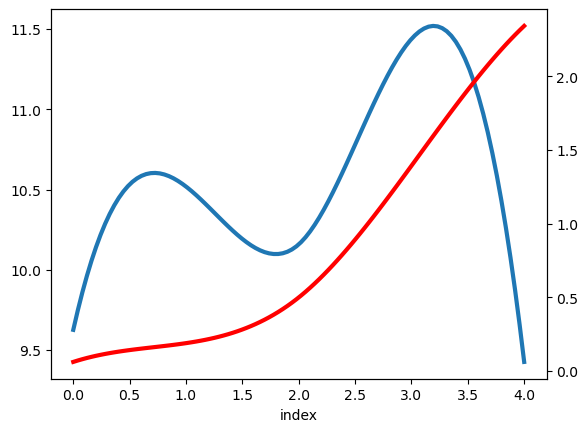

In [203]:
smooth_gene_peaks_plot("Krt27", "latent_time_3", 3, points=100, save="figs/Hair/krt27.pdf")

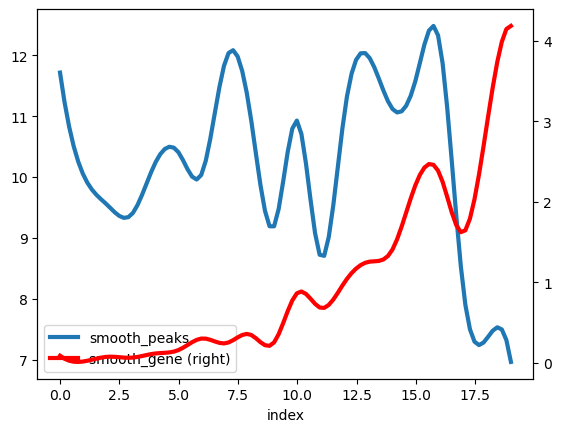

In [196]:
smooth_gene_peaks_plot("Krt27", "latent_time_cat", 3, points=100)

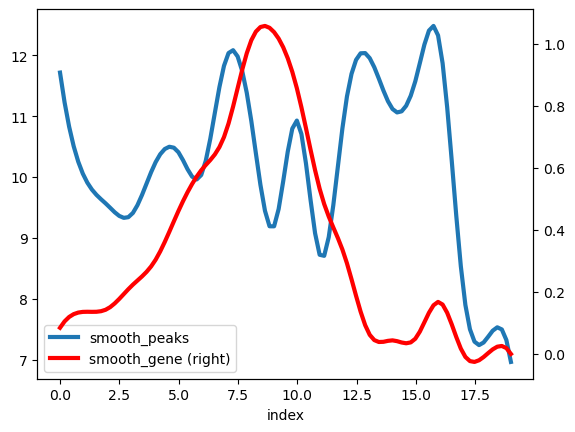

In [180]:
smooth_gene_peaks_plot("Dsg4", "latent_time_cat", 3, points=100)

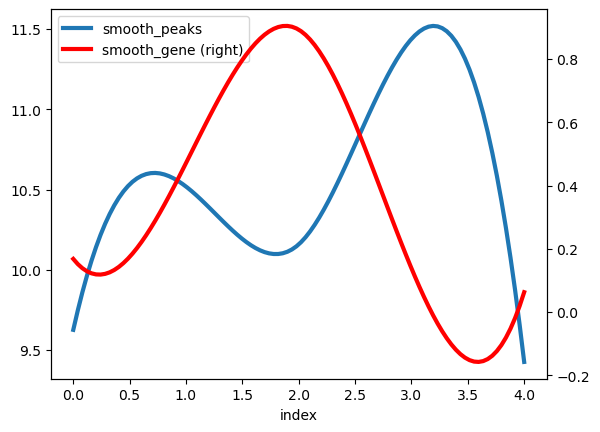

In [197]:
smooth_gene_peaks_plot("Dsg4", "latent_time_3", 3, points=100)

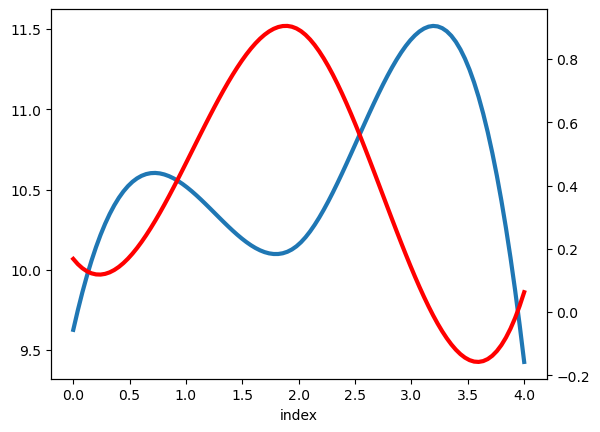

In [204]:
smooth_gene_peaks_plot("Dsg4", "latent_time_3", 3, points=100, save="figs/Hair/dsg4.pdf")

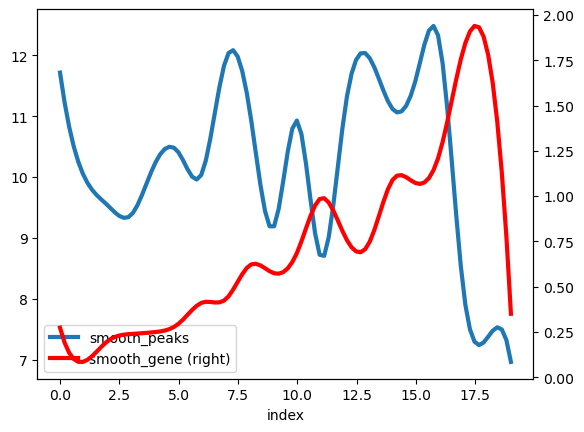

In [184]:
smooth_gene_peaks_plot("Ctsc", "latent_time_cat", 3, points=100)

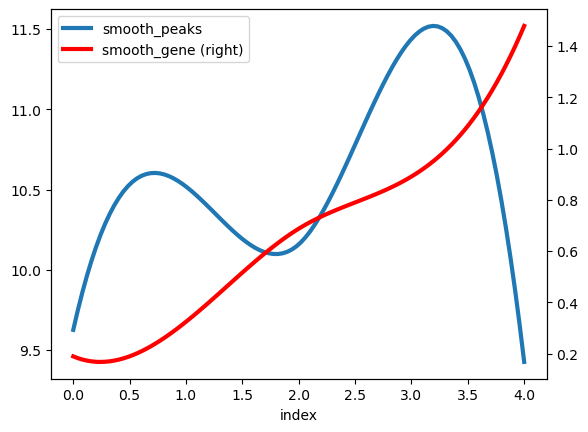

In [198]:
smooth_gene_peaks_plot("Ctsc", "latent_time_3", 3, points=100)

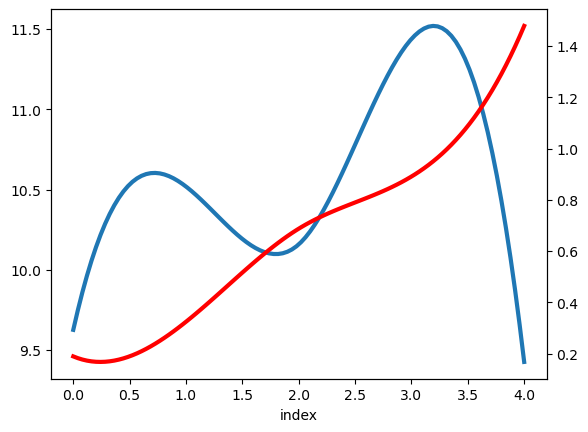

In [205]:
smooth_gene_peaks_plot("Ctsc", "latent_time_3", 3, points=100, save="figs/Hair/ctsc.pdf")

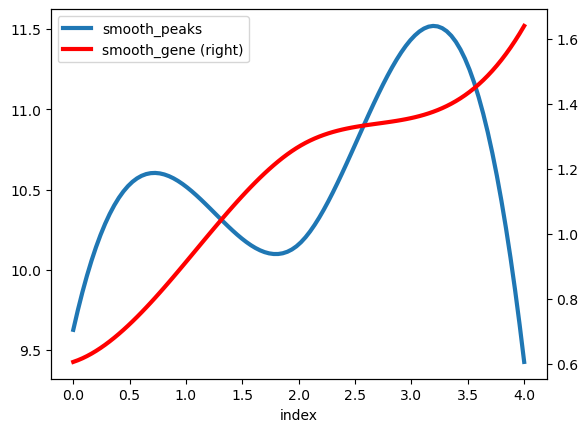

In [200]:
smooth_gene_peaks_plot("Mical2", "latent_time_3", 3, points=100)

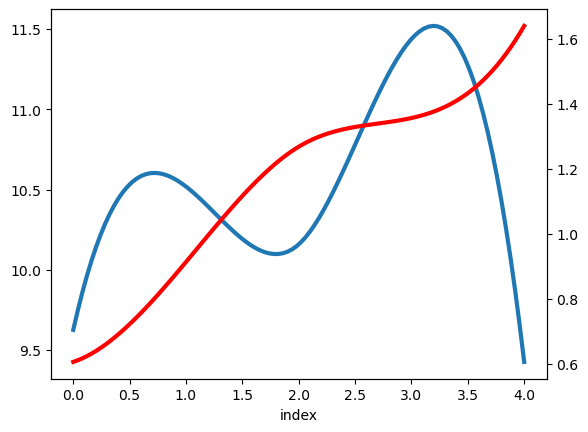

In [206]:
smooth_gene_peaks_plot("Mical2", "latent_time_3", 3, points=100, save="mical2.pdf")

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


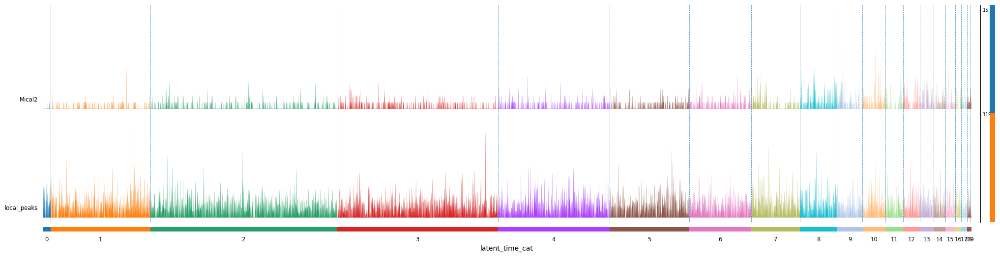

In [63]:
genes_dict = {"decoupled":"Mical2", "atac": 'local_peaks'} 
get_gene_local_atac("MICAL2", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

Mical2


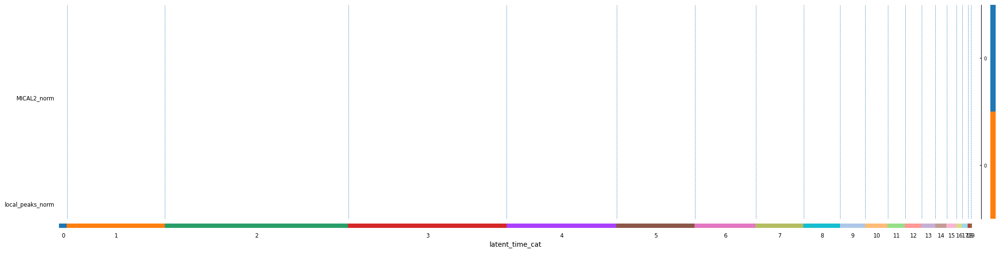

In [77]:
genes_dict = {"decoupled":"MICAL2_norm", "atac": 'local_peaks_norm'} 
get_norm_gene_local("MICAL2", "latent_time_cat")
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

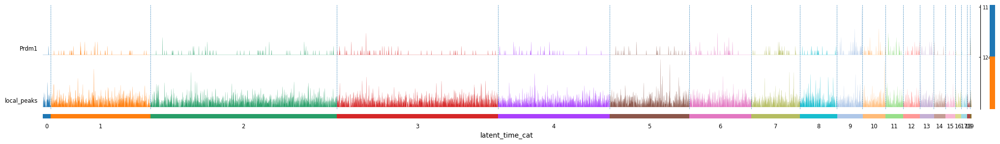

In [27]:
genes_dict = {"decoupled":"Prdm1", "atac": 'local_peaks'} 
get_gene_local_atac("PRDM1", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 3])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


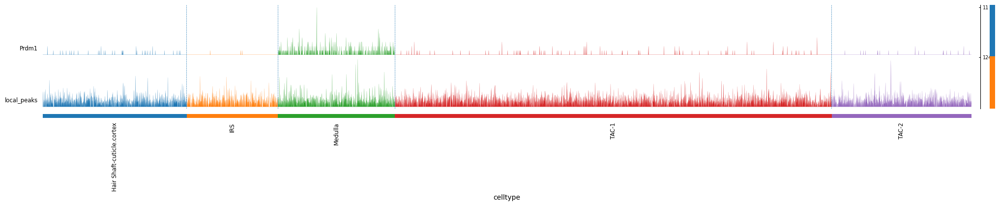

In [31]:
genes_dict = {"decoupled":"Prdm1", "atac": 'local_peaks'} 
get_gene_local_atac("PRDM1", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='celltype', dendrogram=False, figsize=[25, 3])

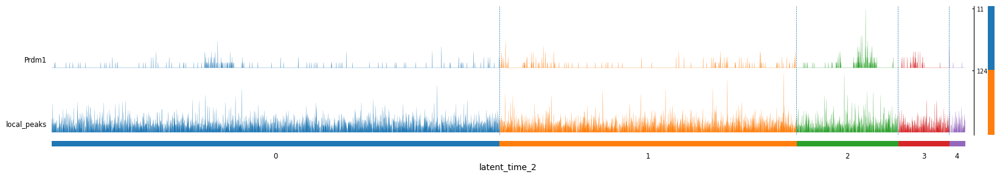

In [34]:

genes_dict = {"decoupled":"Prdm1", "atac": 'local_peaks'} 
get_gene_local_atac("PRDM1", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_2', dendrogram=False, figsize=[20, 3])

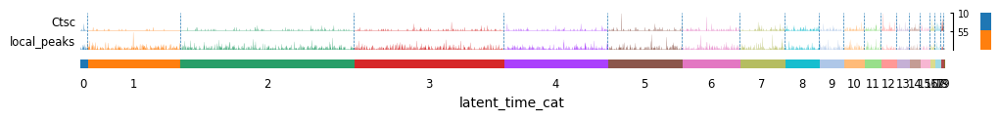

In [45]:
genes_dict = {"decoupled":"Ctsc", "atac": 'local_peaks'} 
get_gene_local_atac("CTSC", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[20, 3], linewidths=20)
# ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, linewidths=20)


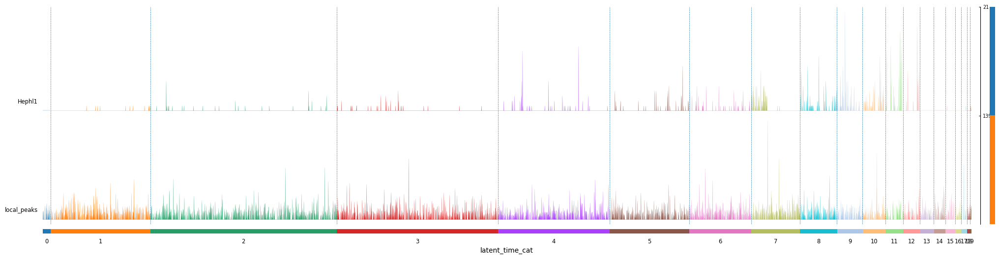

In [187]:
genes_dict = {"decoupled":"Hephl1", "atac": 'local_peaks'} 
get_gene_local_atac("HEPHL1", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

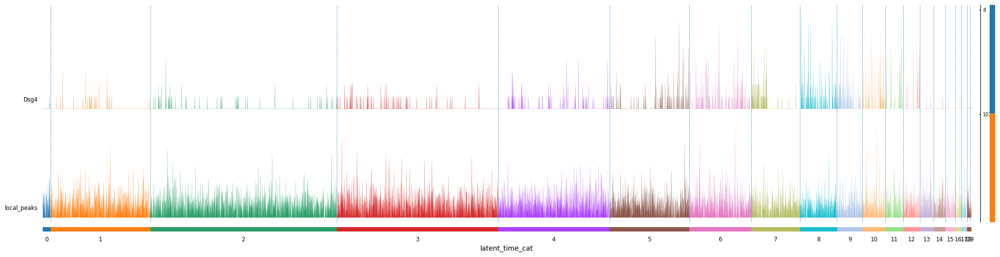

In [37]:
genes_dict = {"decoupled":"Dsg4", "atac": 'local_peaks'} 
get_gene_local_atac("DSG4", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

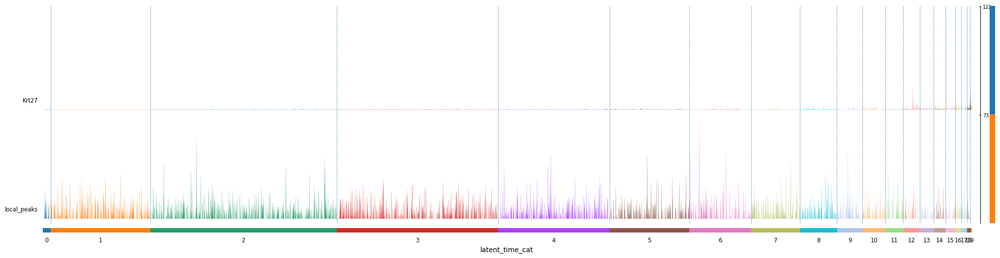

In [189]:
genes_dict = {"decoupled":"Krt27", "atac": 'local_peaks'} 
get_gene_local_atac("KRT27", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

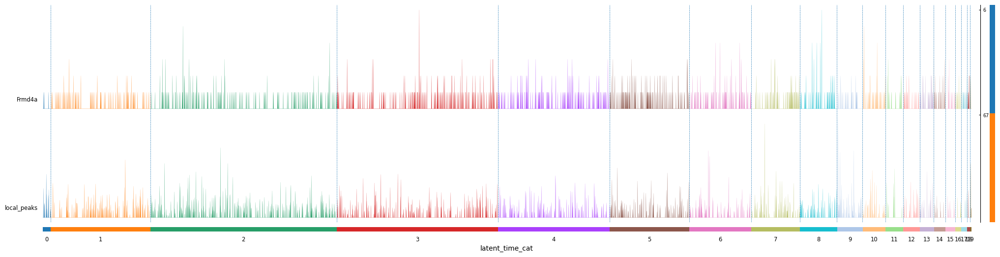

In [191]:
genes_dict = {"decoupled":"Frmd4a", "atac": 'local_peaks'} 
get_gene_local_atac("FRMD4A", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

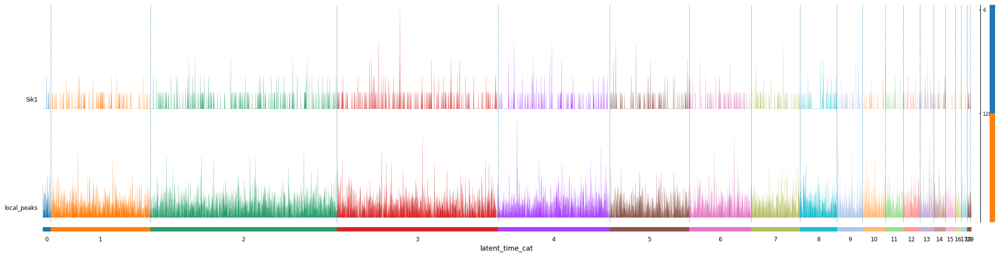

In [40]:
genes_dict = {"Coupled":"Sik1", "atac": 'local_peaks'} 
get_gene_local_atac("SIK1", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

In [60]:
set(atac_data.uns["TSS_metadata"]["gene"]) & set(rna_data.var_names.to_list())

{'BC005561', 'F3'}

In [15]:
atac_data

AnnData object with n_obs × n_vars = 3365 × 123883
    obs: 'celltype', 'batch_id', 'modality', 'latent_time', '_scvi_batch', '_scvi_labels', 'latent_decouple', 'latent_couple', 'latent_1', 'latent_2', 'latent_3', 'latent_4', 'latent_5', 'latent_6', 'latent_7', 'latent_8', 'latent_9', 'latent_10', 'topic_0', 'topic_1', 'topic_2', 'topic_3', 'topic_4', 'topic_5', 'topic_6', 'topic_7', 'topic_8', 'topic_9', 'topic_10', 'topic_11', 'topic_12', 'topic_13', 'topic_14', 'softmax_denom'
    var: 'chr', 'start', 'end', 'n_cells', 'types'
    uns: 'TSS_metadata', 'celltype_colors', 'distance_to_TSS_genes', 'motifs', 'neighbors', 'topic_dendogram', 'umap'
    obsm: 'X_topic_compositions', 'X_umap', 'X_umap_features', 'latent'
    varm: 'distance_to_TSS', 'motifs_hits', 'topic_feature_activations', 'topic_feature_compositions'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [88]:
rp_args = dict(expr_adata = rna_data, atac_adata= atac_data)
rp_genes = list(rna_model.features[rna_model.highly_variable])
rp_genes = [str(e).upper() for e in rp_genes] + ['B3GALT1',"CSMD1"]
# rp_genes = rp_genes[:3]
# for topic in range(rna_model.num_topics):
#     rp_genes.extend(rna_model.get_top_genes(topic, 200))
# rp_genes = list(set(rp_genes))
# rp_genes = [str(e).upper() for e in rp_genes] + ['TPM1', "GRIN2B", "VCAN", "NRP1", "ROBO1", "GM29260", "MCFD2", "SF3B3", "HMRHL", "ATXN1", "FABP7", "CELSR1", "CTCF"]
# rp_genes.remove("GM5089-1")
# rp_genes.remove("PAKAP-1")

In [84]:
## add individual genes

rp_genes = ["ACVR2A"]

In [89]:
litemodel = mira.rp.LITE_Model(expr_model = rna_model,
                              accessibility_model=atac_model,
                              counts_layer='counts',
                              genes = rp_genes)

In [86]:
## training the model
litemodel.fit(**rp_args, n_workers=4,
              callback = mira.rp.SaveCallback("rpmodels/mira/"))

Fitting models: 100%|██████████| 1/1 [00:00<00:00, 54.21it/s]


In [90]:
litemodel.load("rpmodels/mira/")

In [264]:
table = litemodel["GM29260"].get_influential_local_peaks(atac_data, decay_periods = 5.)
table

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


,chr,start,end,n_cells,types,distance_to_TSS,is_upstream
peak_id,,,,,,,
1316,chr1,41228022,41228417,42,neither,553588.0,True
1317,chr1,41235922,41236450,69,neither,545621.0,True
1318,chr1,41244173,41245176,291,neither,537133.0,True
1319,chr1,41246684,41246922,33,neither,535004.0,True
1320,chr1,41270535,41273453,362,coupled,509813.0,True
...,...,...,...,...,...,...,...
1374,chr1,42256914,42263499,1228,coupled,478399.0,False
1375,chr1,42267005,42267292,38,decoupled,485341.0,False
1376,chr1,42277139,42277540,40,neither,495532.0,False


In [53]:
rna_data.obs["softmax_denom"]

AAACAGCCAACCGCCA-1_paired    3245.729736
AAACAGCCAAGGTCGA-1_paired    2208.164062
AAACAGCCAGGAACAT-1_paired    2234.916748
AAACAGCCATATTGAC-1_paired    1950.110107
AAACAGCCATGGTTAT-1_paired    3075.645508
                                ...     
TTTGTGGCATAATCGT-1_paired    3378.617676
TTTGTGGCATTTGCTC-1_paired    3228.003174
TTTGTGTTCAATGACC-1_paired    3536.458252
TTTGTTGGTGGAGCAA-1_paired    1879.951782
TTTGTTGGTTAGAGCC-1_paired    3126.578857
Name: softmax_denom, Length: 3365, dtype: float32

In [54]:
atac_data.obs["softmax_denom"]

AAACAGCCAACCGCCA-1_paired    149936.312500
AAACAGCCAAGGTCGA-1_paired    121729.578125
AAACAGCCAGGAACAT-1_paired    132883.796875
AAACAGCCATATTGAC-1_paired    128868.601562
AAACAGCCATGGTTAT-1_paired    139185.562500
                                 ...      
TTTGTGGCATAATCGT-1_paired    132496.671875
TTTGTGGCATTTGCTC-1_paired    154130.109375
TTTGTGTTCAATGACC-1_paired    147261.781250
TTTGTTGGTGGAGCAA-1_paired    142052.687500
TTTGTTGGTTAGAGCC-1_paired    155582.046875
Name: softmax_denom, Length: 3365, dtype: float32

In [37]:
from scipy.sparse import csr_matrix
from scipy.sparse import diags

def tfidf_norm(adata_atac, scale_factor=1e4):
    """TF-IDF normalization.
    This function normalizes counts in an AnnData object with TF-IDF.
    Parameters
    ----------
    adata_atac: :class:`~anndata.AnnData`
        ATAC anndata object.
    scale_factor: `float` (default: 1e4)
        Value to be multiplied after normalization.
    copy: `bool` (default: `False`)
        Whether to return a copy or modify `.X` directly.
    Returns
    -------
    If `copy==True`, a new ATAC anndata object which stores normalized counts in `.X`.
    """
    npeaks = adata_atac.X.sum(1)
    npeaks_inv = csr_matrix(1.0/npeaks)
    tf = adata_atac.X.multiply(npeaks_inv)
    idf = diags(np.ravel(adata_atac.X.shape[0] / adata_atac.X.sum(0))).log1p()
    new_X = tf.dot(idf) * scale_factor
    return new_X


In [38]:
norm_X = tfidf_norm(atac_data)

In [35]:
def aggregate_local_atac(table, norm_X):
    indices = table.index.to_numpy().astype(np.int64)
    gene_peaks = norm_X[:, indices]
    gene_peaks = np.sum(gene_peaks, axis=1)
    
    return gene_peaks

def get_gene_local_atac(genename, litemodel, rna_data, atac_data, norm_X):
    table = litemodel[genename].get_influential_local_peaks(atac_data, decay_periods = 5.)
    peaks = aggregate_local_atac(table, norm_X)
    rna_data.obs["local_peaks"] = peaks

def get_gene_local_atac_mtx(genenames, litemodel, rna_data, atac_data, norm_X):
    for genename in genenames:
        table = litemodel[genename].get_influential_local_peaks(atac_data, decay_periods = 5.)
        peaks = aggregate_local_atac(table, norm_X)
        name = genename+"local_peaks"
        rna_data.obs[name] = peaks



In [ ]:
def plot_track_pairs(genenames,  litemodel, rna_data, atac_data, norm_X):
    get_gene_local_atac_mtx(genenames, litemodel, rna_data, atac_data, norm_X)
    gene_dict = []



categories: 0, 1, 2, etc.
var_group_labels: decoupled, atac


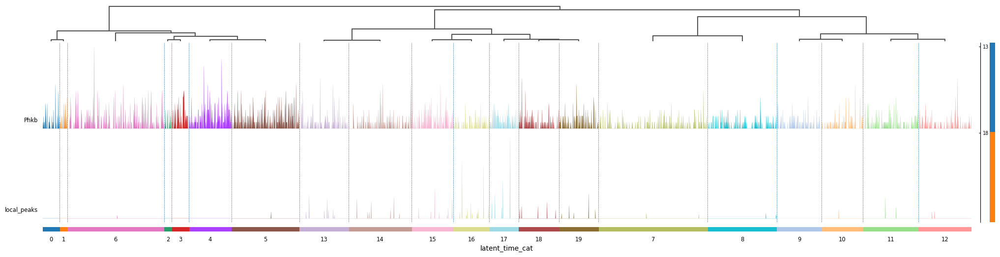

In [50]:
genes_dict = {"decoupled":"Phkb", "atac": 'local_peaks'} 
get_gene_local_atac("PHKB", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=True, figsize=[25, 6])

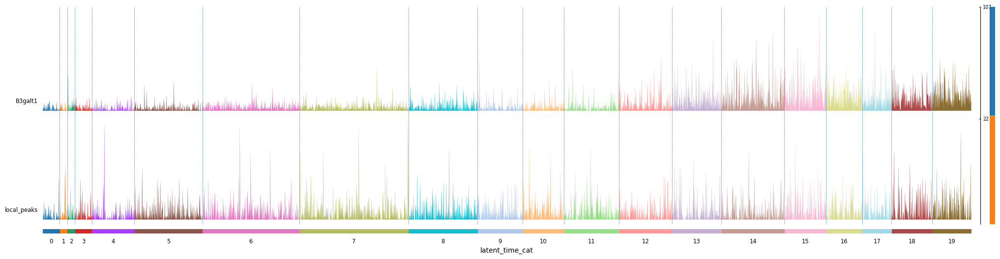

In [92]:

genes_dict = {"decoupled":"B3galt1", "atac": 'local_peaks'} 
get_gene_local_atac("B3GALT1", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', figsize=[25, 6])

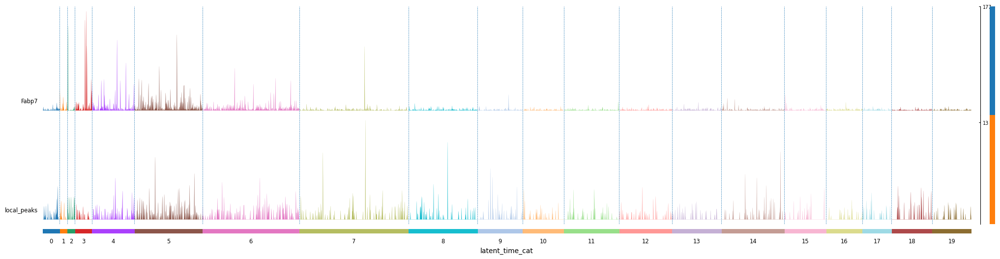

In [60]:

genes_dict = {"decoupled":"Fabp7", "atac": 'local_peaks'} 
get_gene_local_atac("FABP7", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', figsize=[25, 6])

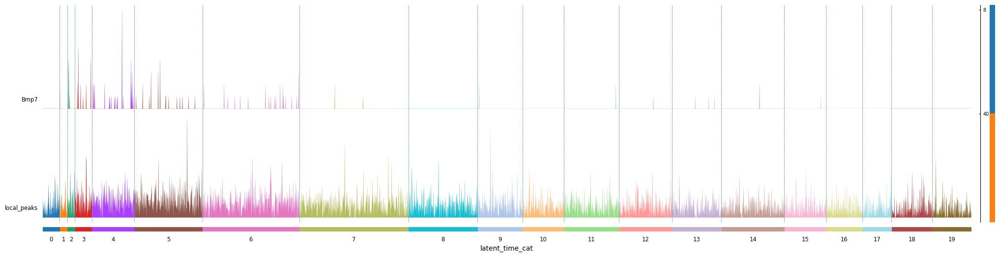

In [61]:
genes_dict = {"decoupled":"Bmp7", "atac": 'local_peaks'} 
get_gene_local_atac("BMP7", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', figsize=[25, 6])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


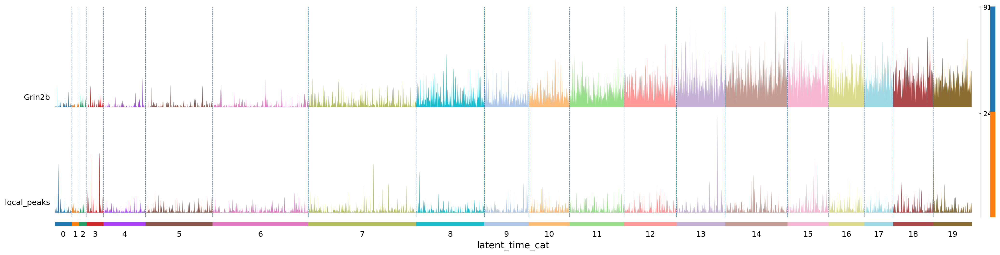

In [235]:
genes_dict = {"coupled":"Grin2b", "atac": 'local_peaks'} 
get_gene_local_atac("GRIN2B", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

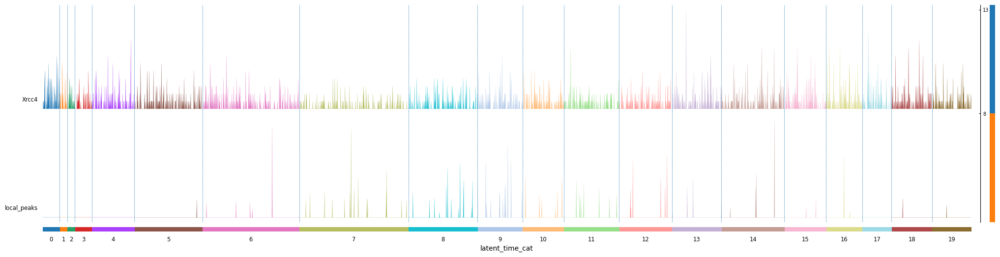

In [94]:
genes_dict = {"coupled":"Xrcc4", "atac": 'local_peaks'} 
get_gene_local_atac("XRCC4", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


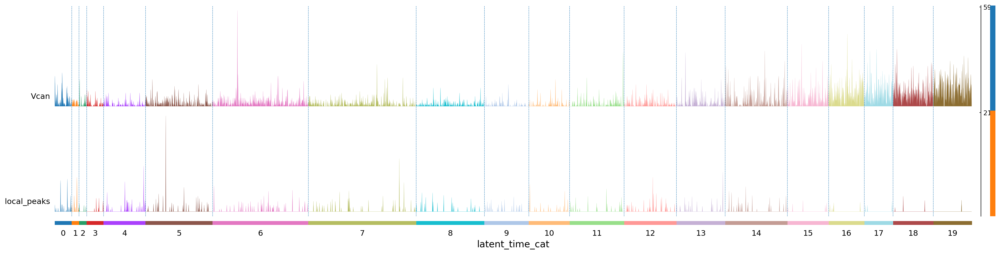

In [244]:
genes_dict = {"decoupled":"Vcan", "atac": 'local_peaks'} 
get_gene_local_atac("VCAN", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


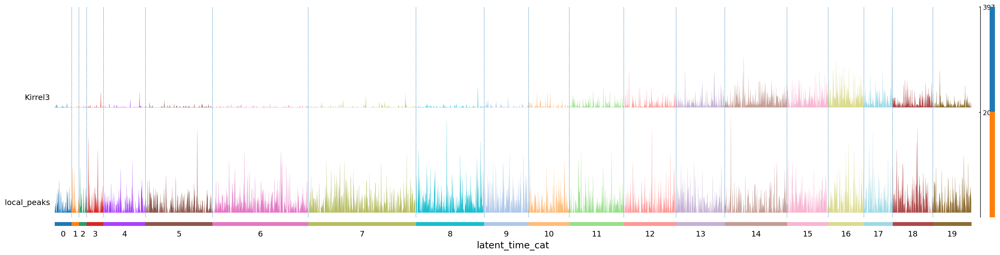

In [254]:
genes_dict = {"decoupled":"Kirrel3", "atac": 'local_peaks'} 
get_gene_local_atac("KIRREL3", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


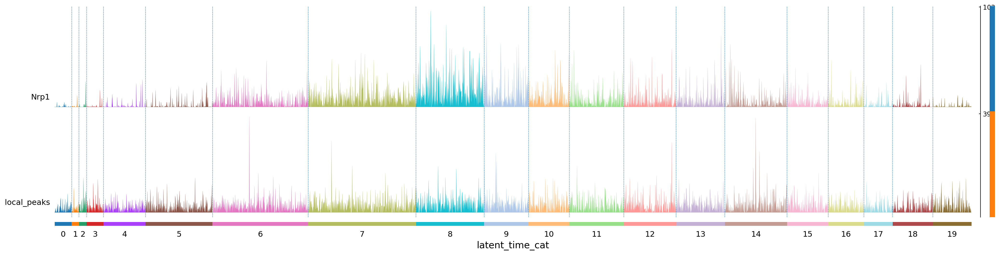

In [249]:
genes_dict = {"decoupled":"Nrp1", "atac": 'local_peaks'} 
get_gene_local_atac("NRP1", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


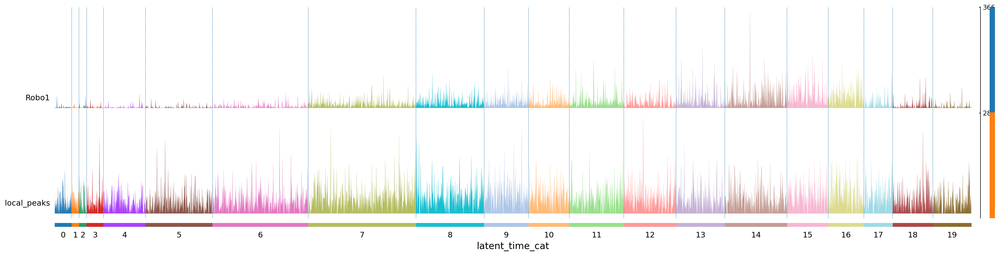

In [253]:
genes_dict = {"decoupled":"Robo1", "atac": 'local_peaks'} 
get_gene_local_atac("ROBO1", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat',  figsize=[25, 6])

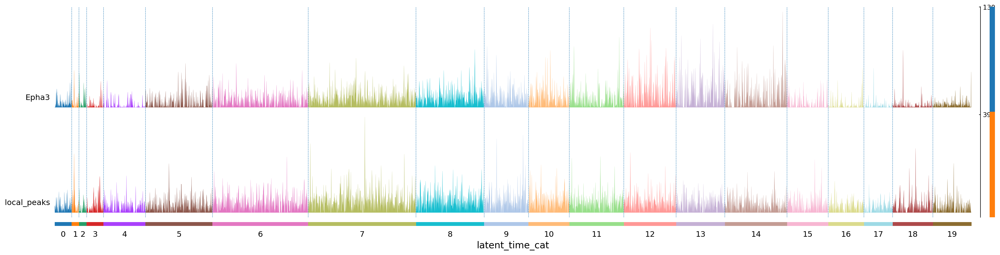

In [255]:
genes_dict = {"decoupled":"Epha3", "atac": 'local_peaks'} 
get_gene_local_atac("EPHA3", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat',  figsize=[25, 6])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


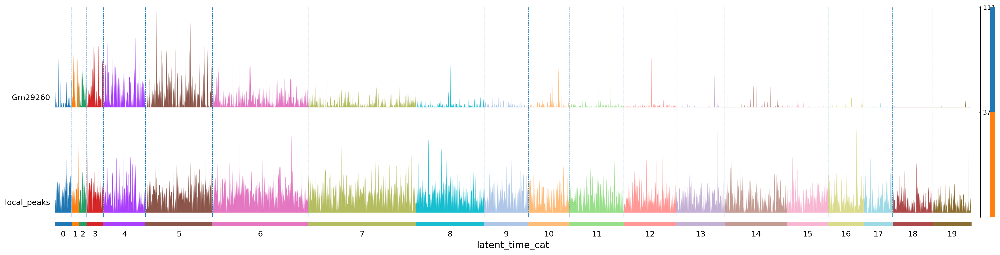

In [266]:
genes_dict = {"decoupled":"Gm29260", "atac": 'local_peaks'} 

get_gene_local_atac("GM29260", litemodel, rna_data, atac_data, norm_X)
ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', figsize=[25, 6])

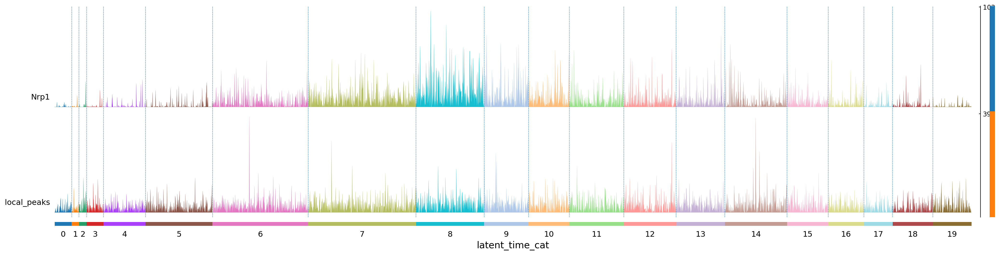

In [176]:
get_gene_local_atac("NRP1", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Nrp1", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', figsize=[25, 6])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


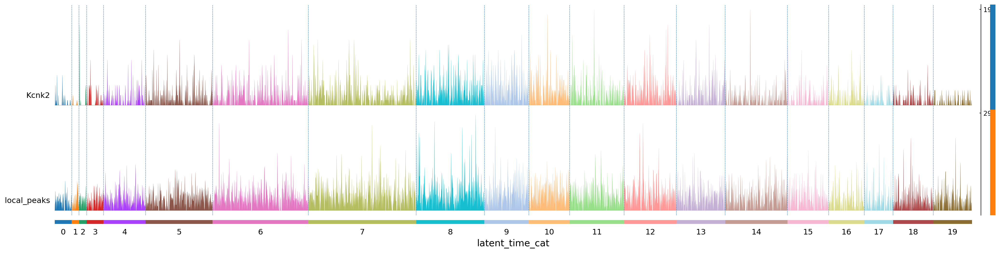

In [171]:
get_gene_local_atac("KCNK2", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Kcnk2", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', figsize=[25, 6])


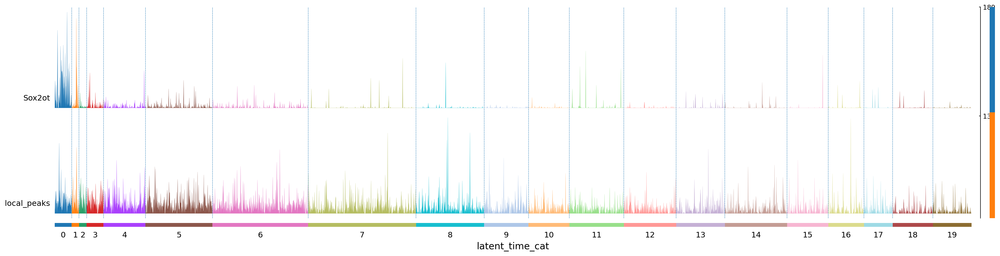

In [172]:
get_gene_local_atac("SOX2OT", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Sox2ot", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

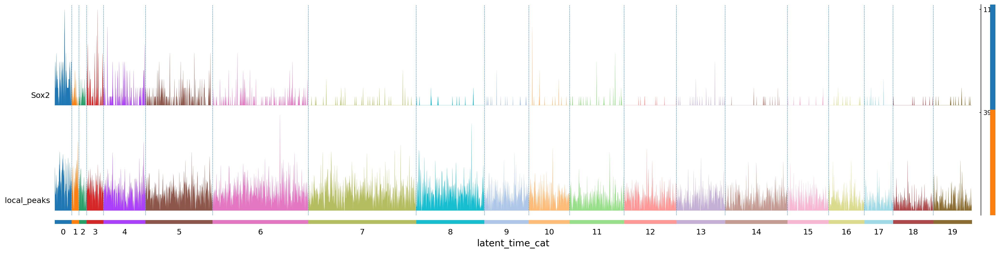

In [173]:
get_gene_local_atac("SOX2", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Sox2", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

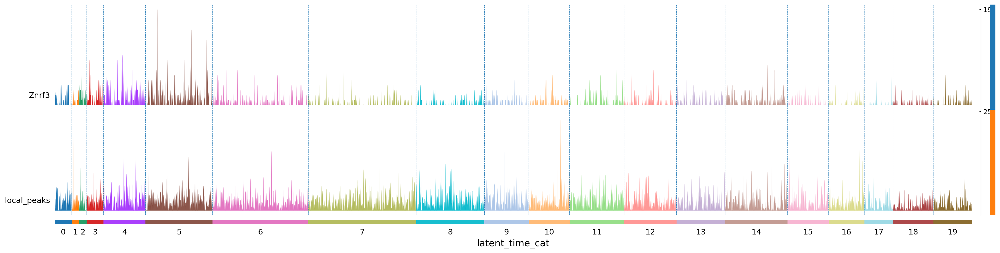

In [174]:
get_gene_local_atac("ZNRF3", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Znrf3", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


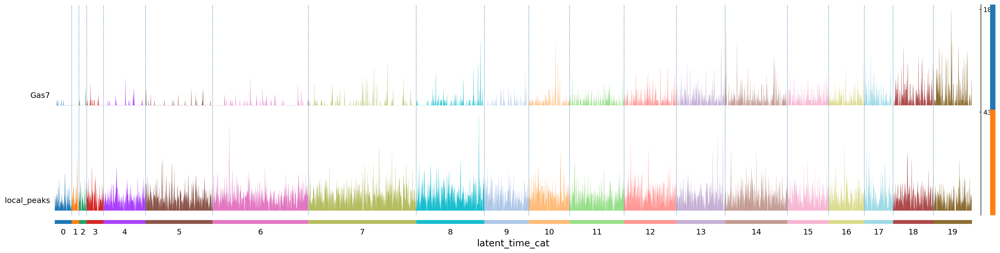

In [214]:
get_gene_local_atac("GAS7", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Gas7", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

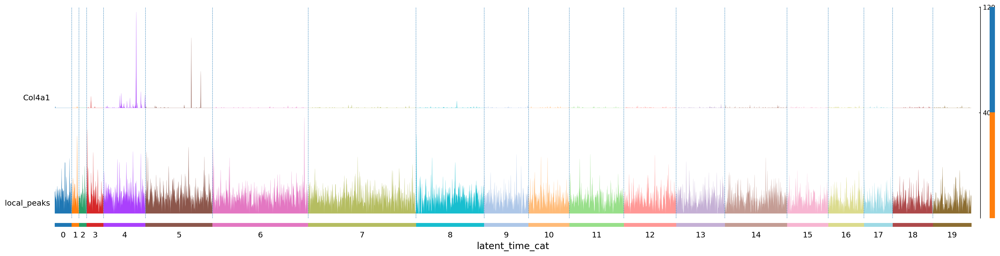

In [188]:
#MCFD2
get_gene_local_atac("COL4A1", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Col4a1", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

In [219]:
##MVP
get_gene_local_atac("ROBO2", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Robo2", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

IndexError: Model for gene ROBO2 does not exist

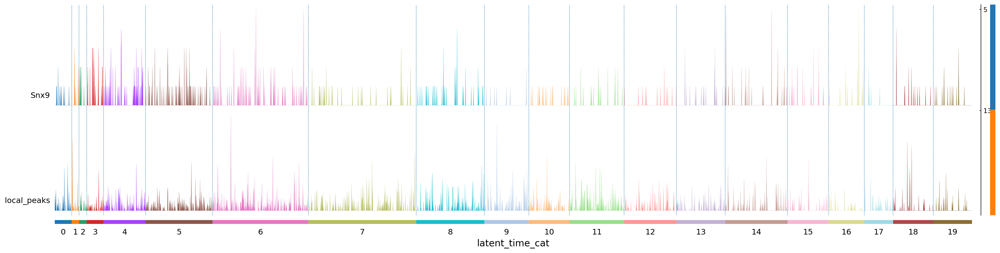

In [215]:
##SNX9
get_gene_local_atac("SNX9", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Snx9", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

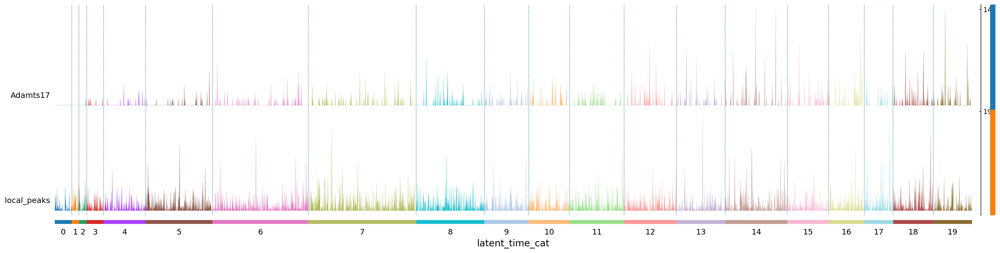

In [218]:
#RELB

get_gene_local_atac("ADAMTS17", litemodel, rna_data, atac_data, norm_X)
genes_dict = {"decoupled":"Adamts17", "atac": 'local_peaks'} 

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=False, figsize=[25, 6])

In [212]:
rna_data.var.reset_index()[rna_data.var.index=="TPM1"]

,index,gene_ids,feature_types,modality,n_cells,highly_variable,means,dispersions,dispersions_norm,exog,endog,types,logp,coupled_score,decouple_score
7554,TPM1,ENSMUSG00000032366,Gene Expression,Gene Expression,1127,True,0.406586,0.78738,0.607321,True,False,decoupled,0.0,-4.334617,6.1051


In [74]:
rna_data.write_h5ad("data/datasets/mouse_brain_rna_mira_local.h5ad")


In [82]:
couple_genes = ['Foxp1','Lrrtm4', 'Vcan','Sik3','Dph6','Rgma','Arhgap20','Itgb3bp','Ttyh1']

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


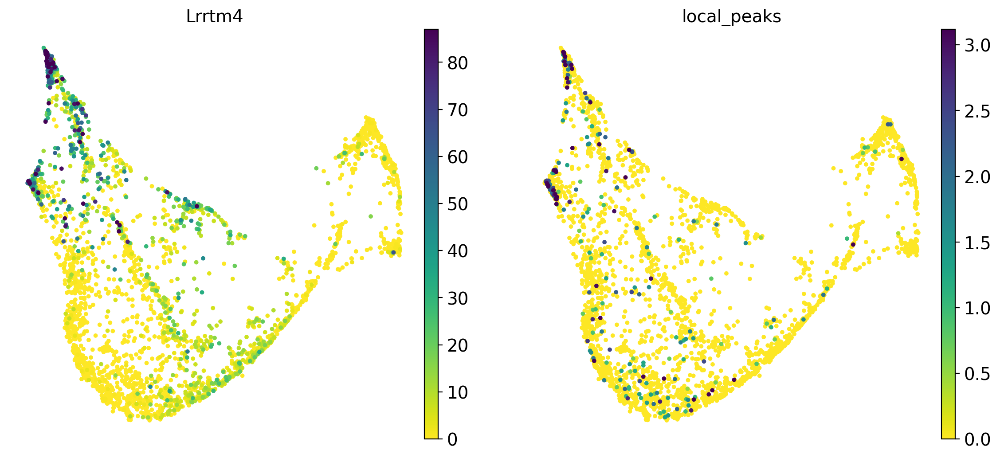

In [75]:
get_gene_local_atac("LRRTM4", litemodel, rna_data, atac_data, norm_X)
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(rna_data, color=['Lrrtm4', "local_peaks"], s=50, frameon=False, ncols=2, vmax='p99')


/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


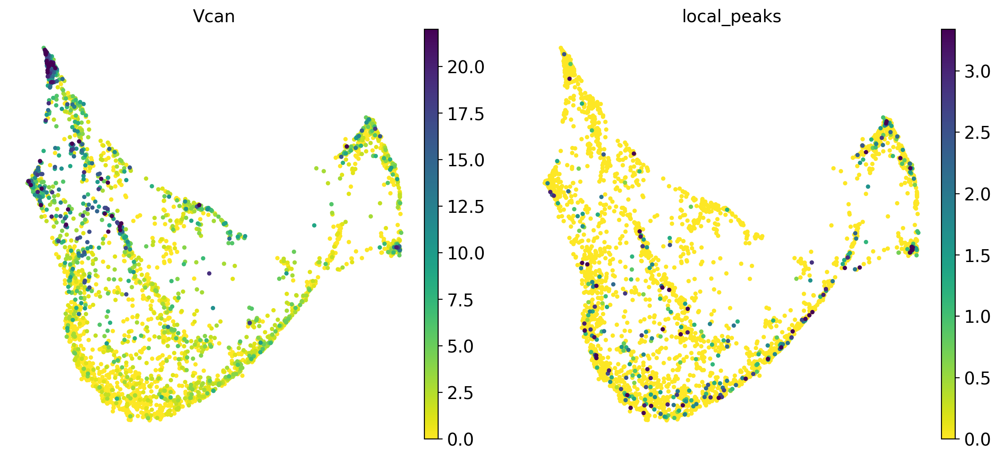

In [76]:
get_gene_local_atac("VCAN", litemodel, rna_data, atac_data, norm_X)
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(rna_data, color=['Vcan', "local_peaks"], s=50, frameon=False, ncols=2, vmax='p99')


/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


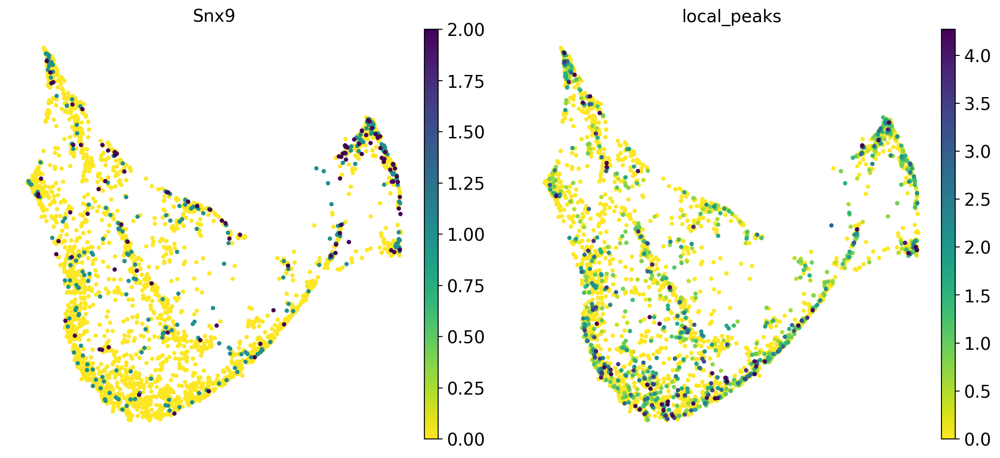

In [94]:
#Itgb3bp

get_gene_local_atac("SNX9", litemodel, rna_data, atac_data, norm_X)
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(rna_data, color=['Snx9', "local_peaks"], s=50, frameon=False, ncols=2, vmax='p99')

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


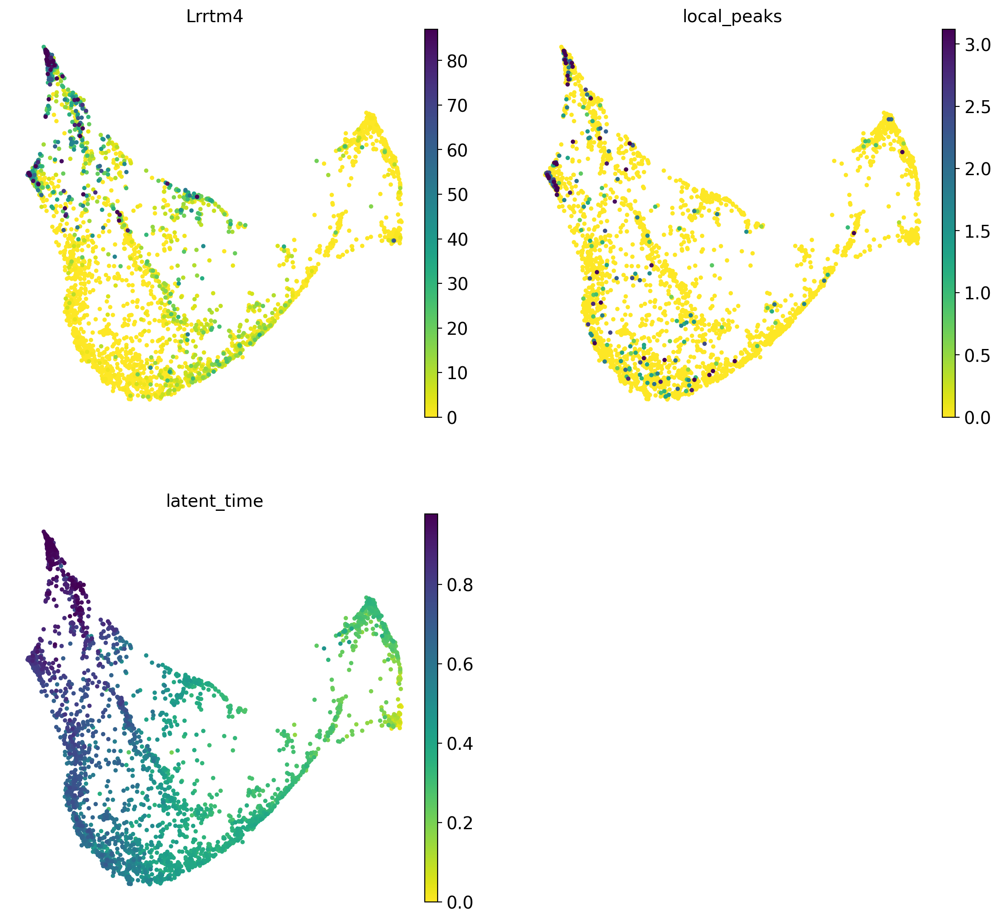

In [88]:
get_gene_local_atac("LRRTM4", litemodel, rna_data, atac_data, norm_X)
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(rna_data, color=['Lrrtm4', "local_peaks", "latent_time"], s=50, frameon=False, ncols=2, vmax='p99')

KeyError: '4932441j04rik'

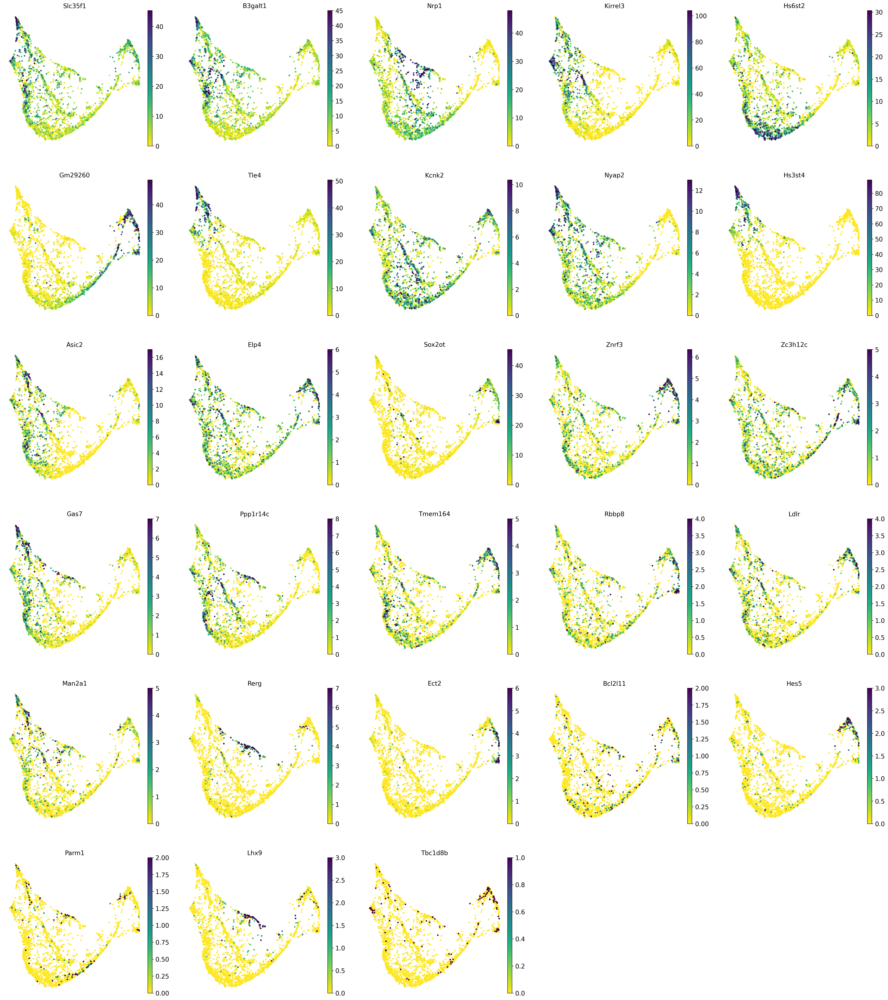

In [96]:
decouple_genes = ['SLC35F1', 'B3GALT1', 'NRP1', 'KIRREL3', 'HS6ST2', 'GM29260', 'TLE4',
       'KCNK2', 'NYAP2', 'HS3ST4', 'ASIC2', 'ELP4', 'SOX2OT', 'ZNRF3',
       'ZC3H12C', 'GAS7', 'PPP1R14C', 'TMEM164', 'RBBP8', 'LDLR', 'MAN2A1',
       'RERG', 'ECT2', 'BCL2L11', 'HES5', 'PARM1', 'LHX9', 'TBC1D8B',
       '4932441J04RIK', 'RGS4']
decouple_genes = [str(e).capitalize() for e in decouple_genes]       
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(rna_data, color=decouple_genes, s=50, frameon=False, ncols=5, vmax='p99')

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


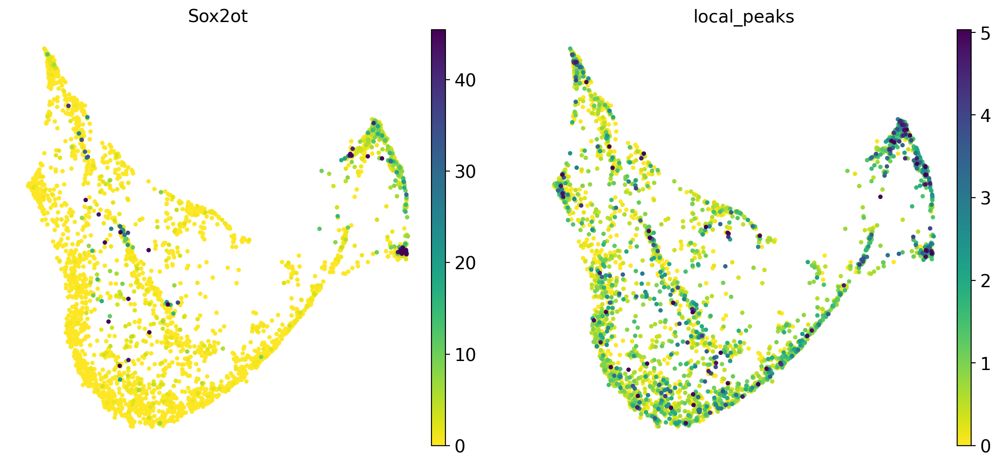

In [138]:

get_gene_local_atac("SOX2OT", litemodel, rna_data, atac_data, norm_X)
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(rna_data, color=["Sox2ot", "local_peaks"], s=50, frameon=False, ncols=5, vmax='p99')

/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:295: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['distance_to_TSS'] = np.abs(dist)
/home/haiyi/anaconda3/envs/halo2/lib/python3.7/site-packages/mira/adata_interface/rp_model.py:296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  proximal_peaks['is_upstream'] = dist <= 0


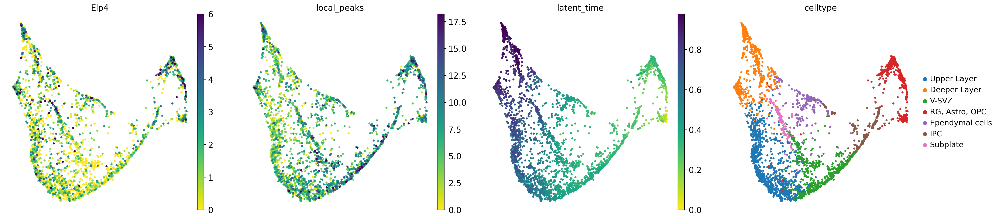

In [105]:
get_gene_local_atac("ELP4", litemodel, rna_data, atac_data, norm_X)
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.umap(rna_data, color=["Elp4", "local_peaks", "latent_time", "celltype"], s=50, frameon=False, ncols=5, vmax='p99')

In [139]:
genes_dict = {"decoupled":"Sox2ot", "atac": 'local_peaks'} 

categories: 0, 1, 2, etc.
var_group_labels: decoupled, atac


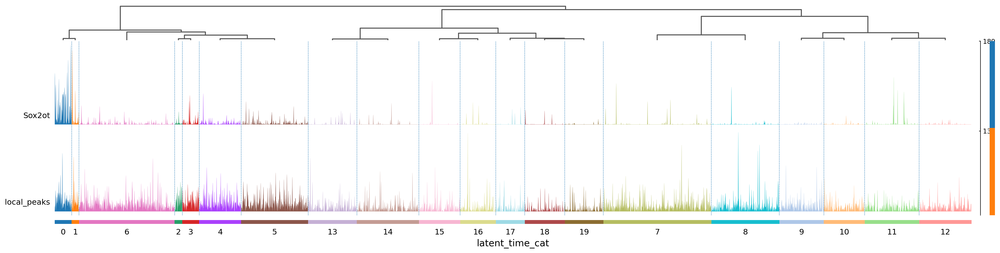

In [147]:
genes_dict = {"decoupled":"Sox2ot", "atac": 'local_peaks'} 
get_gene_local_atac("SOX2OT", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=True, figsize=[25, 6])

categories: 0, 1, 2, etc.
var_group_labels: decoupled, atac


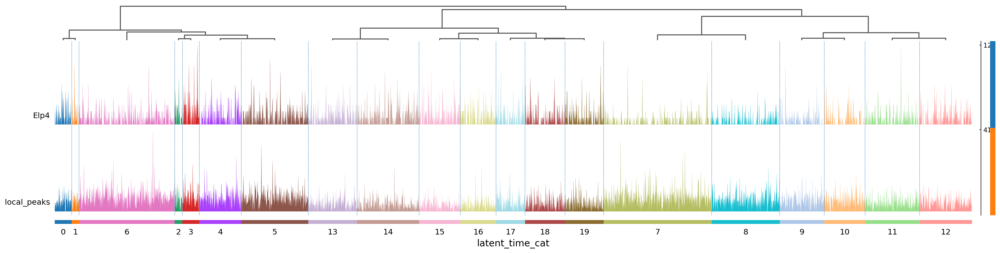

In [146]:
genes_dict = {"decoupled":"Elp4", "atac": 'local_peaks'} 
get_gene_local_atac("ELP4", litemodel, rna_data, atac_data, norm_X)

ax = sc.pl.tracksplot(rna_data, genes_dict, groupby='latent_time_cat', dendrogram=True, figsize=[25, 6])

In [132]:
rna_data.obs["latent_time_cat"] = pd.cut(rna_data.obs['latent_time'], 20, labels=[str(i) for i in range(20)])


In [128]:
names = ["latent_"+str(i) for i in range(1, 11)]
names

['latent_1',
 'latent_2',
 'latent_3',
 'latent_4',
 'latent_5',
 'latent_6',
 'latent_7',
 'latent_8',
 'latent_9',
 'latent_10']

In [129]:
rna_data.obs = rna_data.obs.drop(names, axis=1)


,celltype,batch_id,modality,latent_time,_scvi_batch,_scvi_labels,latent_decouple,latent_couple,test_set,topic_0,...,topic_9,topic_10,topic_11,topic_12,topic_13,topic_14,model_read_scale,softmax_denom,local_peaks,latent_time_cat
AAACAGCCAACCGCCA-1_paired,Upper Layer,1,paired,0.604954,0,0,0.426128,0.978945,False,0.044863,...,0.435679,0.071903,0.020078,0.074781,0.000367,0.036394,6.915498,3245.729736,5.176158,"(0.6, 0.65]"
AAACAGCCAAGGTCGA-1_paired,"RG, Astro, OPC",1,paired,0.281341,0,0,0.086842,0.828030,False,0.015316,...,0.001202,0.004536,0.657100,0.003350,0.000142,0.004700,7.536094,2208.164062,7.731575,"(0.25, 0.3]"
AAACAGCCAGGAACAT-1_paired,Deeper Layer,1,paired,0.851495,0,0,-1.055951,-2.345383,False,0.008210,...,0.001070,0.006007,0.001719,0.007430,0.001279,0.043208,8.246658,2234.916748,4.326788,"(0.85, 0.9]"
AAACAGCCATATTGAC-1_paired,Deeper Layer,1,paired,0.982605,0,0,-0.678755,-1.834370,False,0.010064,...,0.003312,0.012114,0.003180,0.025199,0.001130,0.105735,7.352932,1950.110107,5.400655,"(0.95, 1.0]"
AAACAGCCATGGTTAT-1_paired,Subplate,1,paired,0.549869,0,0,0.122593,-0.642178,False,0.020677,...,0.034497,0.024388,0.012385,0.021237,0.000628,0.018268,7.005153,3075.645508,3.333803,"(0.5, 0.55]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTGGCATAATCGT-1_paired,Ependymal cells,1,paired,0.454965,0,0,0.412956,-1.799858,True,0.478498,...,0.029641,0.037600,0.004146,0.008559,0.000731,0.005659,8.261782,3378.617676,1.676358,"(0.45, 0.5]"
TTTGTGGCATTTGCTC-1_paired,Upper Layer,1,paired,0.598991,0,0,0.239816,0.199178,False,0.016300,...,0.272781,0.130449,0.004899,0.269730,0.000371,0.056904,7.010578,3228.003174,9.296640,"(0.55, 0.6]"
TTTGTGTTCAATGACC-1_paired,IPC,1,paired,0.291581,0,0,0.911365,1.677551,False,0.199888,...,0.005637,0.003558,0.126949,0.002514,0.000051,0.002700,6.931353,3536.458252,5.084594,"(0.25, 0.3]"
TTTGTTGGTGGAGCAA-1_paired,Deeper Layer,1,paired,0.776289,0,0,-0.187027,-2.587236,True,0.016205,...,0.002026,0.007967,0.001137,0.008923,0.000911,0.199967,7.842948,1879.951782,0.000000,"(0.75, 0.8]"
